In [1]:
import scanpy as sc
import pandas as pd
from matplotlib import pylab
import random
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import os
import itertools
import plotly.express as px
import yaml


import numpy as np
import random
import anndata as ad
from scipy.sparse import  csr_matrix, issparse
from scipy import sparse

from matplotlib.colors import TwoSlopeNorm

import scanpy.external as sce
import sys

import scvelo as scv

In [2]:
import anndata

In [3]:

sc.settings.set_figure_params(dpi=80, facecolor='white', dpi_save=500)
pylab.rcParams['figure.figsize'] = (6, 6)
homeDir = os.getenv("HOME")
sys.path.insert(1, homeDir+"/utils/")

from PlotPCA_components import *
from AtlasClasses import *
DS="androgen_substudy"
ReferenceTissue="cortex"

with open(homeDir+"/utils/ReferenceDict.yaml", 'r') as file:
    ReferencePaths = yaml.safe_load(file)
    for k in list(ReferencePaths.keys()):
        ReferencePaths[k]["adataPath"] = "/group/testa/Users/davide.castaldi/Polaroids_spinoff"+ReferencePaths[k]["adataPath"]
        #ReferencePaths[k]["signaturePath"] = homeDir+ReferencePaths[k]["signaturePath"]
        ReferencePaths[k]["signaturePath"] = "/group/testa/Users/davide.castaldi/Polaroids_spinoff"+ReferencePaths[k]["signaturePath"]
        ReferencePaths[k]["signaturePurityPath"] = "/group/testa/Users/davide.castaldi/Polaroids_spinoff"+ReferencePaths[k]["signaturePurityPath"]


ReferencePaths


{'cortex': {'dsname': 'Poliudakis2019_cortex',
  'adataPath': '/group/testa/Users/davide.castaldi/Polaroids_spinoff/2_GenerateReferences/cortex.Reference.h5ad',
  'signaturePath': '/group/testa/Users/davide.castaldi/Polaroids_spinoff/2_GenerateReferences/cortex.SignatureGenes.tsv',
  'signaturePurityPath': '/group/testa/Users/davide.castaldi/Polaroids_spinoff/2_GenerateReferences/cortex.SignaturesPurity.tsv',
  'LabelTtransferAggregation': {'oRG': 'Glia',
   'IP': 'IP',
   'ExcitatoryDeepLayer': 'ExcitatoryNeuron',
   'Cycling': 'Cycling',
   'ExcitatoryMigrating': 'ExcitatoryNeuron',
   'Excitatory': 'ExcitatoryNeuron',
   'Endothelium': 'Vascular',
   'vRG': 'Glia',
   'Inhibitory': 'ForebrainInhibitory',
   'OPC': 'OPC',
   'Mic': 'Mic'},
  'RelevantContrasts': {'Inh_vs_Exc': ['cortex_Inhibitory',
    'cortex_Excitatory'],
   'Exc_vs_cycling': ['cortex_Excitatory', 'cortex_CyclingProgenitors']}},
 'cerebellum': {'dsname': 'Aldinger2021_cerebellum',
  'adataPath': '/group/testa/Users

# Import

In [4]:
adata = sc.read_h5ad("./adatas/4.4.{}.labeltransfer.h5ad".format(DS))
adata.layers["logNorm"] = adata.X.copy()

## Scaled cell cycle score

In [5]:
sc.pp.scale(adata)

In [6]:
scv.tl.score_genes_cell_cycle(adata)


calculating cell cycle phase
-->     'S_score' and 'G2M_score', scores of cell cycle phases (adata.obs)


# Go back to log counts

In [7]:
adata.X = adata.layers["logNorm"].copy()
del adata.layers["logNorm"]


236
PlottingParams: figsize:(10, 10) dpi:100 dotsize:10 legend_loc:on data fontsize:8


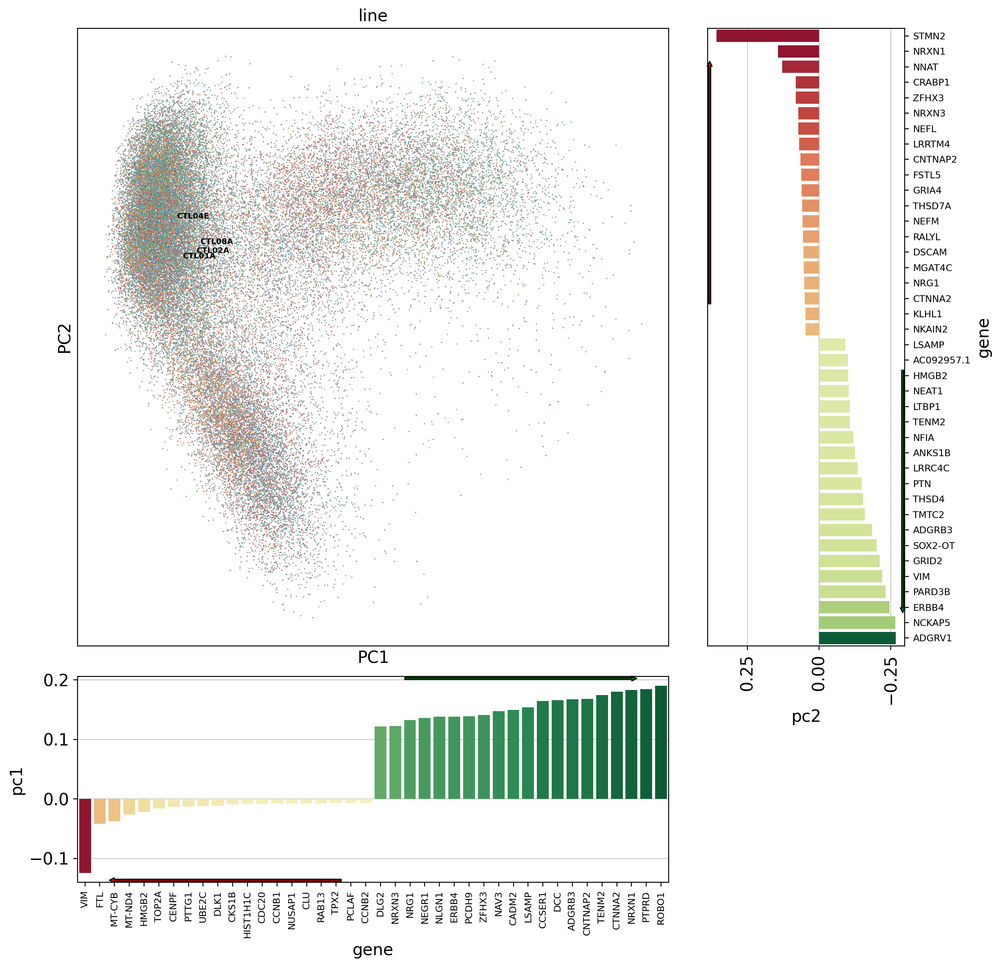

In [8]:
# Store consensus call info
adata.obs["Consensus_nIntersection"] = adata.obs[["ingestdLabels","scANVILabels","harmonyLabels"]].apply(lambda rows: rows.value_counts().max(), axis = 1)
adata.obs["Consensus"] = np.where(adata.obs["Consensus_nIntersection"] >= 2, True, False)
adata.obs["Consensus_call"] = adata.obs[["ingestdLabels","scANVILabels","harmonyLabels"]].apply(lambda rows: rows.value_counts().idxmax(), axis = 1)


sc.pp.highly_variable_genes(adata, batch_key="groupCov", flavor="seurat", n_top_genes=4000)
CommonHVGs = adata.var_names[adata.var["highly_variable_nbatches"] == len(adata.obs["groupCov"].unique())].tolist()
print(len(CommonHVGs))
adata.var["highly_variable"] = adata.var_names.isin(CommonHVGs)
adata.var["highly_variable"].sum()
sc.tl.pca(adata)
plotPCA_components(adata, color="line")

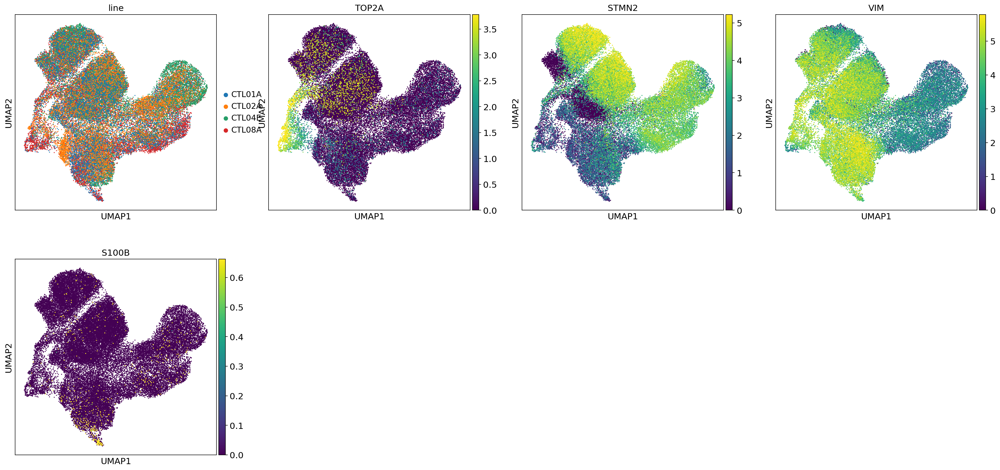

In [9]:
sc.pp.neighbors(adata, n_pcs=10, n_neighbors=30)
sc.tl.umap(adata)
sc.pl.umap(adata, color=["line","TOP2A","STMN2","VIM","S100B"], size=10, vmin='p1', vmax='p99')

# Check additional filters mapping

In [10]:
AddedFilters = pd.read_csv("./adatas/{}_AdditionalFilters.tsv".format(DS), sep="\t", index_col=0)
del adata.obs["condition_clean"]
if pd.concat([adata.obs, AddedFilters], axis = 1).loc[adata.obs_names].isnull().any(axis=1).sum() == (adata.obs.shape[0] - AddedFilters.shape[0]):
    print("(Mis)match between Additional filters tsv and anndata as expected, proceeding to merge")
    adata.obs = pd.concat([adata.obs, AddedFilters], axis = 1).loc[adata.obs_names]
    for col in AddedFilters.columns:
        adata.obs[col] = adata.obs[col].fillna(False)
else:
    print("Unexpected dimension mismatch between Additional filters tsv and anndata")


(Mis)match between Additional filters tsv and anndata as expected, proceeding to merge


In [11]:
plotSankey(adata.obs, covs=["Consensus_call"]+AddedFilters.columns.tolist())

In [12]:
plotObs = adata.obs.copy()
plotObs["Consensus_nIntersection"] = plotObs["Consensus_nIntersection"].astype(str)
plotSankey(plotObs, covs=["Consensus_nIntersection"]+AddedFilters.columns.tolist())

In [13]:
# Filter out cells with high criticasl signature scores
adata = adata[adata.obs[[i for i in adata.obs.columns if "PassedQCfilt_ScoreSignature_" in i]].sum(axis = 1) >= 3].copy()

In [14]:
adata.write("./adatas/5.1.{}.PostQC.h5ad".format(DS))

In [15]:
"./adatas/5.1.{}.PostQC.h5ad".format(DS)

'./adatas/5.1.androgen_substudy.PostQC.h5ad'